---

  <center>
    <font size='2'><b>Data Visualization - Final Project</font><br>
    <font size='6'>Global CO₂ Emissions Analysis: Drivers, Trends, and Policy Recommendations</font><br>
  </center>

---

<center>
    <font size='3'>Data Science, Columbian College of Arts & Sciences, George Washington University
    <br>
    Prudhvi Chekuri, Satya Phanindra Kumar Kalaga, Deepika Reddygari.
    </font><br>

![green energy](https://ec.europa.eu/eurostat/documents/4187653/15727800/maykal_AdobeStock_511151036_RV.jpg)
</center>

# Table of Contents
1. [Introduction](#introduction)
2. [Description of the Data](#description-of-the-data)
3. [Analysis of Data Quality](#analysis-of-data-quality)
4. [Main Analysis](#main-analysis)
5. [Key Findings](#key-findings)
6. [Conclusion](#conclusion)
7. [References](#references)
---


# Introduction
- **Topic Selection**: <TODO: Change this>
  CO₂ emissions are a major concern for the environment and are a key driver of climate change. Paris Agreement, which was signed by 195 countries, aims to limit global warming to 1.5°C. The agreement requires countries to set their own targets for reducing CO₂ emissions. In this project, we aim to analyze the main drivers of CO₂ emissions, trends in CO₂ emissions over time, and policy recommendations to reduce CO₂ emissions.

- **Research Questions**:
  
  1. What are the main drivers of CO₂ emissions?
  2. What are the trends in CO₂ emissions over time?
  3. What are the policy recommendations to reduce CO₂ emissions?

- **Team Member Contributions**: 
  - Deepika Reddygari: <TODO: Change this>
  - Prudhvi Chekuri: <TODO: Change this>
  - Satya Phanindra Kumar Kalaga: <TODO: Change this>

## Why?

- CO2 is one of the most pressing problems. 
- Primary driver of climate change.
- One of our climate goals based on Paris Agreement is to limit the global warming to 1.5 C.

## Questions

1. Which countries have contributed the most to global CO₂ emissions?
2. Which countries have the highest per capita CO₂ emissions annually and why?
3. How do CO₂ emissions vary across income groups globally?

## Description of the Data

All the data used for answering first three questions was collected from Gapminder.

Data sources:
- CO2 emissions for countries year-by-year from 1800 to 2022 ([link](https://docs.google.com/spreadsheets/d/1t_GOXGrXQgSasIB7dWfRrq9dkqjrqwy3xHvywH7ah1A/edit?gid=176703676#gid=176703676)).
- Population for countries year-by-year from 1800 to 2100 ([link](https://www.gapminder.org/data/) / population indicator / population).
- GNI per capita for countries year-by-year from 1800 to 2050 ([link](https://www.gapminder.org/data/) / incomes&growth indicator / GNI per capita (Atlas Method)).

# Question 1: *Which countries have contributed the most to global CO₂ emissions?*

## Import required packages

In [48]:
import pandas as pd
import plotly.graph_objects as go

import warnings
warnings.filterwarnings("ignore")

## Load Data

In [49]:
data = pd.read_csv('data/CO2 Consumption emissions  1800 - 2022 - Dataset - v2 - Data source.csv', header=1)
data.head()

,country,name,time,MtCo2 (Million Tons of CO2),tCO2 per cap (Tonnes of CO2 per Cap)
0,afg,Afghanistan,1800,0.002452,0.000748
1,afg,Afghanistan,1801,0.002460,0.000750
2,afg,Afghanistan,1802,0.002468,0.000752
3,afg,Afghanistan,1803,0.002476,0.000755
4,afg,Afghanistan,1804,0.002484,0.000757


In [50]:
data.columns = ['country_code', 'country', 'year', 'CO2_emissions (Million Tons of CO2)', 'CO2_emissions_per_capita (Tonnes of CO2 per person)']
data.head()

,country_code,country,year,CO2_emissions (Million Tons of CO2),CO2_emissions_per_capita (Tonnes of CO2 per person)
0,afg,Afghanistan,1800,0.002452,0.000748
1,afg,Afghanistan,1801,0.002460,0.000750
2,afg,Afghanistan,1802,0.002468,0.000752
3,afg,Afghanistan,1803,0.002476,0.000755
4,afg,Afghanistan,1804,0.002484,0.000757


**Data Description**:

- *country_code* - country abbreviation
- *country* - country name
- *year* - year
- *CO2_emissions (Million Tons of CO2)* - CO2 emissions of a country in a specific year.
- *CO2_emissions_per_capita (Tonnes of CO2 per person)* - Per Capita CO2 emissions of a country in a specific year.

## EDA (Exploratory Data Analysis)

In [51]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43262 entries, 0 to 43261
Data columns (total 5 columns):
 #   Column                                               Non-Null Count  Dtype  
---  ------                                               --------------  -----  
 0   country_code                                         43262 non-null  object 
 1   country                                              43262 non-null  object 
 2   year                                                 43262 non-null  int64  
 3   CO2_emissions (Million Tons of CO2)                  43262 non-null  float64
 4   CO2_emissions_per_capita (Tonnes of CO2 per person)  43262 non-null  float64
dtypes: float64(2), int64(1), object(2)
memory usage: 1.7+ MB


In [52]:
data.describe()

,year,CO2_emissions (Million Tons of CO2),CO2_emissions_per_capita (Tonnes of CO2 per person)
count,43262.000000,43262.000000,43262.000000
mean,1911.000000,39.715254,1.589907
std,64.374652,296.781026,3.921418
min,1800.000000,-2.173577,-0.578870
25%,1855.000000,0.005455,0.010791
50%,1911.000000,0.077639,0.097717
75%,1967.000000,3.484647,0.988852
max,2022.000000,10628.351000,62.150074


Since the minimum value for co2 emissions is a negative value, which shouldn't be a case. Let's explore the samples.

In [53]:
data[data["CO2_emissions (Million Tons of CO2)"] < 0]['country'].unique(), len(data[data["CO2_emissions (Million Tons of CO2)"] < 0])

(array(['Panama'], dtype=object), 7)

only Panama has 7 erroneous values, so let's remove those values.

In [54]:
data = data[(data["CO2_emissions (Million Tons of CO2)"] > 0) & (data["CO2_emissions_per_capita (Tonnes of CO2 per person)"] > 0)].reset_index(drop=True)
data.head()

,country_code,country,year,CO2_emissions (Million Tons of CO2),CO2_emissions_per_capita (Tonnes of CO2 per person)
0,afg,Afghanistan,1800,0.002452,0.000748
1,afg,Afghanistan,1801,0.002460,0.000750
2,afg,Afghanistan,1802,0.002468,0.000752
3,afg,Afghanistan,1803,0.002476,0.000755
4,afg,Afghanistan,1804,0.002484,0.000757


In [55]:
data.describe(include='object')

,country_code,country
count,43255,43255
unique,194,194
top,afg,Afghanistan
freq,223,223


## Historical CO2 Emissions Worldwide

In [56]:
def create_co2_emissions_animation_with_infographic(data):

    # Prepare data
    data = {
        "year": data.groupby('year')['CO2_emissions (Million Tons of CO2)'].sum().index.to_numpy(),
        "co2_emissions": data.groupby('year')['CO2_emissions (Million Tons of CO2)'].sum().values
    }
    df = pd.DataFrame(data)

    # Skip frames: Use every nth year for faster animations
    n = 1
    df = df.iloc[::n]

    # Create frames for animation
    frames = []
    for year in df['year']:
        filtered_df = df[df['year'] <= year]
        min_y = filtered_df['co2_emissions'].min()  # Find min y value for current frame
        max_y = filtered_df['co2_emissions'].max()  # Find max y value for current frame

        frames.append(go.Frame(
            data=[go.Scatter(
                x=filtered_df["year"],
                y=filtered_df["co2_emissions"],
                mode="lines+markers",
                line=dict(color="blue", width=3),
                marker=dict(size=5, color="blue"),
            )],
            name=str(year),
            layout=go.Layout(
                xaxis={"range": [df['year'].min(), year]},
                yaxis={"range": [min_y - 10, max_y + 10]},
                annotations=[
                    {
                        "x": year,
                        "y": filtered_df["co2_emissions"].iloc[-1],
                        "xref": "x",
                        "yref": "y",
                        "text": f"{year}: {filtered_df['co2_emissions'].iloc[-1]:,.0f} Mt",
                        "showarrow": True,
                        "arrowhead": 2,
                        "ax": -50,
                        "ay": -50,
                        "font": {"size": 12}
                    }
                ]
            )
        ))

    # Slider steps
    slider_steps = []
    for year in df['year']:
        slider_step = {
            "method": "animate",
            "args": [
                [str(year)],
                {
                    "frame": {"duration": 0, "redraw": True},
                    "mode": "immediate",
                    "transition": {"duration": 0}
                }
            ],
            "label": str(year)
        }
        slider_steps.append(slider_step)

    # Create the base figure
    fig = go.Figure(
        data=[go.Scatter(
            x=[df['year'].min()],
            y=[df['co2_emissions'].iloc[0]],
            mode="lines+markers",
            line=dict(color="blue", width=3),
            marker=dict(size=5, color="blue"),
        )],
        layout=go.Layout(
            title="Historical CO2 Emissions",
            xaxis=dict(title="Year", range=[df['year'].min(), df['year'].max()]),
            yaxis=dict(title="CO2 Emissions (Million Tons)", 
                       range=[df['co2_emissions'].min() - 10, df['co2_emissions'].max() + 10]),
            width=1000,
            height=600,
            updatemenus=[{
                "buttons": [
                    {
                        "args": [None, {
                            "frame": {"duration": 100, "redraw": False},
                            "fromcurrent": True,
                            "transition": {"duration": 0}
                        }],
                        "label": "Play",
                        "method": "animate"
                    },
                    {
                        "args": [[None], {
                            "frame": {"duration": 0, "redraw": False},
                            "mode": "immediate",
                            "transition": {"duration": 0}
                        }],
                        "label": "Pause",
                        "method": "animate"
                    }
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 87},
                "showactive": False,
                "type": "buttons",
                "x": 0.1,
                "xanchor": "right",
                "y": 0,
                "yanchor": "top"
            }],
            sliders=[{
                "active": 0,
                "yanchor": "top",
                "xanchor": "left",
                "currentvalue": {
                    "font": {"size": 20},
                    "prefix": "Year: ",
                    "visible": True,
                    "xanchor": "right"
                },
                "transition": {"duration": 300, "easing": "cubic-in-out"},
                "pad": {"b": 10, "t": 50},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": slider_steps
            }]
        ),
        frames=frames
    )

    return fig

fig = create_co2_emissions_animation_with_infographic(data)
fig.show()

Key events:
- Impact of First Industrial revolution (1760-1840).
- Impact of Second industrial revolution with great inventions (1870-1914).
- High Impact of Third industrial revolution (1950-2000), exponential growth.

## Historial CO2 Emissions of Top 7 Emitting Countries

In [57]:
def create_co2_emissions_animation_with_labels(data):
    import pandas as pd
    import plotly.graph_objects as go

    # Identify the top 7 countries by total emissions
    top_countries = (
        data.groupby('country')['CO2_emissions (Million Tons of CO2)'].sum()
        .nlargest(7).index
    )
    top_countries_data = data[data['country'].isin(top_countries)]
    
    aggregated_data = (
        top_countries_data.groupby(['year', 'country'])['CO2_emissions (Million Tons of CO2)']
        .sum().reset_index()
    )
    
    # Create frames for animation
    frames = []
    years = sorted(aggregated_data['year'].unique())
    countries = top_countries

    for year in years:
        filtered_data = aggregated_data[aggregated_data['year'] <= year]
        
        # Determine dynamic ranges
        min_y = filtered_data['CO2_emissions (Million Tons of CO2)'].min()
        max_y = filtered_data['CO2_emissions (Million Tons of CO2)'].max()
        min_x = aggregated_data['year'].min()
        max_x = year

        # One trace per country
        frame_data = []
        annotations = []
        for country in countries:
            country_data = filtered_data[filtered_data['country'] == country]
            frame_data.append(
                go.Scatter(
                    x=country_data["year"],
                    y=country_data["CO2_emissions (Million Tons of CO2)"],
                    mode="lines",
                    name=country
                )
            )
            
            # Add text annotation for the latest data point
            if not country_data.empty and year != 1800:
                latest_year = country_data["year"].iloc[-1]
                latest_emissions = country_data["CO2_emissions (Million Tons of CO2)"].iloc[-1]
                annotations.append({
                    "x": latest_year,
                    "y": latest_emissions,
                    "xref": "x",
                    "yref": "y",
                    "text": f"{country}",
                    "showarrow": False,
                    "font": {"size": 12, "color": "black"},
                    "bgcolor": "rgba(255, 255, 255, 0.7)",
                })
        
        frames.append(go.Frame(
            data=frame_data,
            name=str(year),
            layout=go.Layout(
                xaxis={"range": [min_x, max_x]},
                yaxis={"range": [min_y - 10, max_y + 10]},
                annotations=annotations
            )
        ))

    # Slider steps
    slider_steps = []
    for year in years:
        slider_step = {
            "method": "animate",
            "args": [
                [str(year)],
                {
                    "frame": {"duration": 0, "redraw": True},
                    "mode": "immediate",
                    "transition": {"duration": 0}
                }
            ],
            "label": str(year)
        }
        slider_steps.append(slider_step)

    # Create the base figure
    base_traces = []
    for country in countries:
        initial_data = aggregated_data[aggregated_data['year'] == years[0]]
        country_data = initial_data[initial_data['country'] == country]
        base_traces.append(
            go.Scatter(
                x=country_data["year"],
                y=country_data["CO2_emissions (Million Tons of CO2)"],
                mode="lines",
                name=country
            )
        )

    fig = go.Figure(
        data=base_traces,
        layout=go.Layout(
            title="Historical CO2 Emissions of Top 7 Emitting Countries",
            xaxis=dict(title="Year", range=[aggregated_data['year'].min(), aggregated_data['year'].max()]),
            yaxis=dict(title="CO2 Emissions (Million Tons)",),
            width=950,
            height=600,
            updatemenus=[{
                "buttons": [
                    {
                        "args": [None, {
                            "frame": {"duration": 100, "redraw": False},
                            "fromcurrent": True,
                            "transition": {"duration": 0}
                        }],
                        "label": "Play",
                        "method": "animate"
                    },
                    {
                        "args": [[None], {
                            "frame": {"duration": 0, "redraw": False},
                            "mode": "immediate",
                            "transition": {"duration": 0}
                        }],
                        "label": "Pause",
                        "method": "animate"
                    }
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 87},
                "showactive": False,
                "type": "buttons",
                "x": 0.1,
                "xanchor": "right",
                "y": 0,
                "yanchor": "top"
            }],
            sliders=[{
                "active": 0,
                "yanchor": "top",
                "xanchor": "left",
                "currentvalue": {
                    "font": {"size": 20},
                    "prefix": "Year: ",
                    "visible": True,
                    "xanchor": "right"
                },
                "transition": {"duration": 300, "easing": "cubic-in-out"},
                "pad": {"b": 10, "t": 50},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": slider_steps
            }]
        ),
        frames=frames
    )

    return fig

fig = create_co2_emissions_animation_with_labels(data)
fig.show()

- UK's domination till 19th century.
- US, UK, and Germany were the top contributors in 20th century. 
- Asian countries started to add to the emissions. 
- UK and Germany worked on their emissions.
- US's yearly emissions have been controlled from 2006 which was their peak. 
- Rapid rise of china's emissions due to industrialization and population growth.
- Germany's emissions dip in 1944 is something we would love to explore in future.

## Cummulative CO2 Emissions by Country

In [58]:
def create_cumulative_co2_emissions_animation_no_names_on_first_frame(data):
    # Identify the top 7 countries by total emissions
    top_countries = (
        data.groupby('country')['CO2_emissions (Million Tons of CO2)'].sum()
        .nlargest(7).index
    )
    top_countries_data = data[data['country'].isin(top_countries)]
    
    # Prepare data for cumulative emissions for the selected top countries
    cumulative_data = (
        top_countries_data.sort_values(by=['country', 'year'])
        .groupby('country')
        .apply(lambda x: x.assign(cumulative_emissions=x['CO2_emissions (Million Tons of CO2)'].cumsum()))
        .reset_index(drop=True)
    )
    
    # Create frames for animation
    frames = []
    years = sorted(cumulative_data['year'].unique())
    countries = top_countries

    for year in years:
        filtered_data = cumulative_data[cumulative_data['year'] <= year]
        
        # Determine dynamic ranges
        min_y = filtered_data['cumulative_emissions'].min()
        max_y = filtered_data['cumulative_emissions'].max()
        min_x = cumulative_data['year'].min()
        max_x = year

        frame_data = []
        annotations = []
        for country in countries:
            country_data = filtered_data[filtered_data['country'] == country]
            frame_data.append(
                go.Scatter(
                    x=country_data["year"],
                    y=country_data["cumulative_emissions"],
                    mode="lines",
                    name=country
                )
            )
            
            # Add text annotation at the latest point, only for frames (not for the first frame)
            if year > years[0] and not country_data.empty:
                latest_year = country_data["year"].iloc[-1]
                latest_emissions = country_data["cumulative_emissions"].iloc[-1]
                annotations.append({
                    "x": latest_year,
                    "y": latest_emissions,
                    "xref": "x",
                    "yref": "y",
                    "text": country,
                    "showarrow": False,
                    "font": {"size": 12, "color": "black"},
                    "bgcolor": "rgba(255, 255, 255, 0.7)",
                })
        
        frames.append(go.Frame(
            data=frame_data,
            name=str(year),
            layout=go.Layout(
                xaxis={"range": [min_x, max_x]},
                yaxis={"range": [min_y - 10, max_y + 10]},
                annotations=annotations
            )
        ))

    slider_steps = []
    for year in years:
        slider_step = {
            "method": "animate",
            "args": [
                [str(year)],
                {
                    "frame": {"duration": 0, "redraw": True},
                    "mode": "immediate",
                    "transition": {"duration": 0}
                }
            ],
            "label": str(year)
        }
        slider_steps.append(slider_step)

    base_traces = []
    for country in countries:
        initial_data = cumulative_data[cumulative_data['year'] == years[0]]
        country_data = initial_data[initial_data['country'] == country]
        base_traces.append(
            go.Scatter(
                x=country_data["year"],
                y=country_data["cumulative_emissions"],
                mode="lines",
                name=country
            )
        )

    fig = go.Figure(
        data=base_traces,
        layout=go.Layout(
            title="Cumulative CO2 Emissions of Top 7 Emitting Countries",
            xaxis=dict(title="Year", range=[cumulative_data['year'].min(), cumulative_data['year'].min()]),
            yaxis=dict(title="Cumulative CO2 Emissions (Mt)"),
            width=950,
            height=600,
            updatemenus=[{
                "buttons": [
                    {
                        "args": [None, {
                            "frame": {"duration": 100, "redraw": False},
                            "fromcurrent": True,
                            "transition": {"duration": 0}
                        }],
                        "label": "Play",
                        "method": "animate"
                    },
                    {
                        "args": [[None], {
                            "frame": {"duration": 0, "redraw": False},
                            "mode": "immediate",
                            "transition": {"duration": 0}
                        }],
                        "label": "Pause",
                        "method": "animate"
                    }
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 87},
                "showactive": False,
                "type": "buttons",
                "x": 0.1,
                "xanchor": "right",
                "y": 0,
                "yanchor": "top"
            }],
            sliders=[{
                "active": 0,
                "yanchor": "top",
                "xanchor": "left",
                "currentvalue": {
                    "font": {"size": 20},
                    "prefix": "Year: ",
                    "visible": True,
                    "xanchor": "right"
                },
                "transition": {"duration": 300, "easing": "cubic-in-out"},
                "pad": {"b": 10, "t": 50},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": slider_steps
            }]
        ),
        frames=frames
    )

    return fig

fig = create_cumulative_co2_emissions_animation_no_names_on_first_frame(data)
fig.show()

- United States contributed the most to co2 emissions. 
- UK is the fifth highest emitter of all time.
- China's increase in emissions can be due their rapid economic growth.

# Question2: *Which countries have the highest per capita CO₂ emissions annually and why?*

## Install and import required libraries

In [59]:
!pip install geopandas==1.0.1 -q


[notice] A new release of pip is available: 23.2.1 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [60]:
import geopandas as gpd
import plotly.express as px

## Prepare data

Fliter the emissions data by year 2022.

In [61]:
per_capita_df = data.query('year == 2022').reset_index(drop=True)
per_capita_df

,country_code,country,year,CO2_emissions (Million Tons of CO2),CO2_emissions_per_capita (Tonnes of CO2 per person)
0,afg,Afghanistan,2022,11.694131,0.284330
1,ago,Angola,2022,43.612097,1.225438
2,alb,Albania,2022,5.976261,2.102599
3,and,Andorra,2022,0.471686,5.909072
4,are,United Arab Emirates,2022,199.411110,21.121532
...,...,...,...,...,...
189,wsm,Samoa,2022,0.317828,1.429201
190,yem,Yemen,2022,13.307629,0.394925
191,zaf,South Africa,2022,310.178658,5.178803
192,zmb,Zambia,2022,8.486580,0.423954


In [62]:
per_capita_df = per_capita_df.drop(['country_code', 'CO2_emissions (Million Tons of CO2)'], axis=1)
per_capita_df.columns

Index(['country', 'year',
       'CO2_emissions_per_capita (Tonnes of CO2 per person)'],
      dtype='object')

Get shape files  using geopandas.

In [63]:
df = per_capita_df.copy()

url = "https://naciscdn.org/naturalearth/50m/cultural/ne_50m_admin_0_countries.zip"
world = gpd.read_file(url)

# Rename and format the GeoDataFrame to match with 'country' column
world = world[['ADMIN', 'geometry']]
world.rename(columns={'ADMIN': 'country'}, inplace=True)

In [64]:
world.head()

,country,geometry
0,Zimbabwe,"POLYGON ((31.28789 -22.40205, 31.19727 -22.344..."
1,Zambia,"POLYGON ((30.39609 -15.64307, 30.25068 -15.643..."
2,Yemen,"MULTIPOLYGON (((53.08564 16.64839, 52.58145 16..."
3,Vietnam,"MULTIPOLYGON (((104.06396 10.39082, 104.08301 ..."
4,Venezuela,"MULTIPOLYGON (((-60.82119 9.13838, -60.94141 9..."


Check if there are any inconsistencies in the country names between dataframes

In [65]:
print(set(df['country']) - set(world['country']))
print(set(world['country']) - set(df['country']))

{'Serbia', 'Slovak Republic', 'Congo, Dem. Rep.', 'St. Vincent and the Grenadines', 'Lao', 'United States', 'Hong Kong, China', 'Bahamas', 'Kyrgyz Republic', 'Micronesia, Fed. Sts.', 'St. Kitts and Nevis', 'Czech Republic', 'Macedonia, FYR', 'Timor-Leste', 'Cape Verde', 'St. Lucia', 'Sao Tome and Principe', 'Congo, Rep.', 'Swaziland', 'Tanzania', "Cote d'Ivoire"}
{'Bermuda', 'South Georgia and the Islands', 'United States Virgin Islands', 'Norfolk Island', 'East Timor', 'Greenland', 'Siachen Glacier', 'Czechia', 'British Indian Ocean Territory', 'Slovakia', 'Aland', 'Turks and Caicos Islands', 'Saint Kitts and Nevis', 'Antarctica', 'Wallis and Futuna', 'Pitcairn Islands', 'Saint Barthelemy', 'Kosovo', 'Republic of Serbia', 'Hong Kong S.A.R.', 'eSwatini', 'Democratic Republic of the Congo', 'Macao S.A.R', 'Indian Ocean Territories', 'Ivory Coast', 'Jersey', 'Laos', 'Somaliland', 'Curaçao', 'Northern Mariana Islands', 'North Macedonia', 'San Marino', 'Saint Pierre and Miquelon', 'Heard I

In [66]:
name_mapping = {
    "Kyrgyz Republic": "Kyrgyzstan",
    "Cote d'Ivoire": "Ivory Coast",
    "Slovak Republic": "Slovakia",
    "Tanzania": "United Republic of Tanzania",
    "Hong Kong, China": "Hong Kong",
    "Congo, Rep.": "Republic of the Congo",
    "Swaziland": "eSwatini",
    "Congo, Dem. Rep.": "Democratic Republic of the Congo",
    "United States": "United States of America",
    "Timor-Leste": "East Timor",
    "Czech Republic": "Czechia",
    "Lao": "Laos",
    "Serbia": "Republic of Serbia",
    "Macedonia, FYR": "North Macedonia",
    "Bahamas": "The Bahamas",
    "Micronesia, Fed. Sts.": "Micronesia",
}

# Apply the mapping to both dataframes
df['country'] = df['country'].replace(name_mapping)
world['country'] = world['country'].replace(name_mapping)

In [67]:
print(set(df['country']) - set(world['country']))
print(set(world['country']) - set(df['country']))

{'Hong Kong', 'St. Kitts and Nevis', 'Cape Verde', 'St. Lucia', 'Micronesia', 'St. Vincent and the Grenadines', 'Sao Tome and Principe'}
{'Bermuda', 'South Georgia and the Islands', 'United States Virgin Islands', 'Norfolk Island', 'Greenland', 'Siachen Glacier', 'British Indian Ocean Territory', 'Aland', 'Turks and Caicos Islands', 'Saint Kitts and Nevis', 'Antarctica', 'Wallis and Futuna', 'Pitcairn Islands', 'Saint Barthelemy', 'Kosovo', 'Hong Kong S.A.R.', 'Macao S.A.R', 'Indian Ocean Territories', 'Jersey', 'Somaliland', 'Curaçao', 'Northern Mariana Islands', 'San Marino', 'Saint Pierre and Miquelon', 'Heard Island and McDonald Islands', 'British Virgin Islands', 'Saint Vincent and the Grenadines', 'Federated States of Micronesia', 'American Samoa', 'Cabo Verde', 'Falkland Islands', 'Montserrat', 'Saint Helena', 'Saint Martin', 'Cayman Islands', 'French Polynesia', 'New Caledonia', 'São Tomé and Principe', 'French Southern and Antarctic Lands', 'Faroe Islands', 'Niue', 'Saint Luci

Some of the inconsistencies are handled.

## Per Capita CO2 Emissions

In [68]:
# Merge data with the GeoDataFrame
merged = world.merge(df, on='country', how='left')

# Plot an interactive choropleth map
fig = px.choropleth(
    merged,
    geojson=merged.geometry,
    locations=merged.index,
    color="CO2_emissions_per_capita (Tonnes of CO2 per person)",
    hover_name="country",
    color_continuous_scale=px.colors.sequential.Reds,
    title="Per Capita CO₂ Emissions (2022)",
    labels={"CO2_emissions_per_capita (Tonnes of CO2 per person)": "Tonnes of CO₂ per Cap"},
    range_color=[0.01, 20],  # Define range for better scaling
    color_continuous_midpoint=1,  # Set midpoint for better visualization of low values
)

# Highlight the country being hovered over
fig.update_traces(marker_line_width=1.5, marker_line_color="black")

# Adjust layout for a larger map
fig.update_geos(
    fitbounds="locations", visible=False,
    projection_scale=1.2,
    showcoastlines=True, coastlinecolor="LightGrey",
    showland=True, landcolor="white",
)

fig.update_layout(
    coloraxis_colorbar=dict(
        title="Tonnes of CO₂<br>per Capita",
        tickvals=[0.1, 1, 5, 10, 20],
        ticktext=["0.1", "1", "5", "10", "20"],
    ),
    title_x=0.5,
    title_font=dict(size=24),
    margin={"r": 0, "t": 50, "l": 0, "b": 0},
    width=1200,
    height=700,
)

fig.show()


- US, Canda, Australia, Saudi has highest per capita emissions.
- These countries are high income countries. 
- Emissions of countries in sub-saharan africa has very low emissions compared to other.

# Question 3: How do CO₂ emissions vary across income groups globally?

## Imports

In [69]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

We need population data, income data, emissions data, and income level data to plot the desired graph.

## Data Preprocessing

### Load Population Data

Population data from Gapminder.
It has population data for all the countries from 1800 to 2024 and it also has projected population values till 2100.

In [70]:
pop_df = pd.read_csv('data/pop.csv')
pop_df

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2091,2092,2093,2094,2095,2096,2097,2098,2099,2100
0,Afghanistan,3.28M,3.28M,3.28M,3.28M,3.28M,3.28M,3.28M,3.28M,3.28M,...,124M,125M,126M,126M,127M,128M,128M,129M,130M,130M
1,Angola,1.57M,1.57M,1.57M,1.57M,1.57M,1.57M,1.57M,1.57M,1.57M,...,139M,140M,142M,143M,144M,145M,147M,148M,149M,150M
2,Albania,400k,402k,404k,405k,407k,409k,411k,413k,414k,...,1.34M,1.32M,1.3M,1.29M,1.27M,1.25M,1.23M,1.22M,1.2M,1.18M
3,Andorra,2650,2650,2650,2650,2650,2650,2650,2650,2650,...,52.8k,52.1k,51.5k,50.8k,50.2k,49.6k,49k,48.4k,47.8k,47.2k
4,UAE,40.2k,40.2k,40.2k,40.2k,40.2k,40.2k,40.2k,40.2k,40.2k,...,24.1M,24.3M,24.5M,24.7M,25M,25.2M,25.4M,25.7M,25.9M,26.1M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,Samoa,47.3k,47.3k,47.3k,47.3k,47.3k,47.3k,47.3k,47.2k,47.2k,...,370k,372k,374k,375k,377k,378k,380k,381k,382k,384k
193,Yemen,2.59M,2.59M,2.59M,2.59M,2.59M,2.59M,2.59M,2.59M,2.59M,...,107M,107M,107M,108M,108M,109M,109M,109M,110M,110M
194,South Africa,1.45M,1.45M,1.46M,1.46M,1.47M,1.47M,1.48M,1.49M,1.49M,...,92.4M,92.6M,92.9M,93.1M,93.3M,93.5M,93.7M,93.9M,94.1M,94.3M
195,Zambia,747k,758k,770k,782k,794k,806k,818k,831k,843k,...,61.1M,61.5M,61.9M,62.3M,62.7M,63.1M,63.4M,63.8M,64.1M,64.5M


Convert the population into numbers.

In [71]:
def convert_to_number(value):
    
    """Convert the population value in string format to a number."""
    
    if isinstance(value, str):
        if 'k' in value:
            return float(value.replace('k', '')) * 1_000
        elif 'M' in value:
            return float(value.replace('M', '')) * 1_000_000
        elif 'B' in value:
            return float(value.replace('B', '')) * 1_000_000_000
    else:
        return value

    return float(value)

Filter the data by year 2022 sicne we only have emissions data till 2022.

In [72]:
pop_df = pop_df[['country', '2022']]
pop_df.columns = ['country', 'population']
pop_df['population'] = pop_df['population'].apply(convert_to_number)
pop_df

,country,population
0,Afghanistan,40600000.0
1,Angola,35600000.0
2,Albania,2830000.0
3,Andorra,79700.0
4,UAE,10200000.0
...,...,...
192,Samoa,215000.0
193,Yemen,38200000.0
194,South Africa,62400000.0
195,Zambia,20200000.0


In [73]:
pop_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 197 entries, 0 to 196
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   country     197 non-null    object 
 1   population  196 non-null    float64
dtypes: float64(1), object(1)
memory usage: 3.2+ KB


### Load Income Data

GNI per capita data from Gapminder. Similar to population data it has data from 1800 to 2050.

In [74]:
income_df = pd.read_csv('data/gnicap_atm_con.csv')
income_df.head()

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2041,2042,2043,2044,2045,2046,2047,2048,2049,2050
0,Afghanistan,207.0,207.0,207.0,207.0,207.0,207.0,207.0,207.0,207.0,...,751,767,783,800,817,834,852,870,888,907
1,Angola,517.0,519.0,522.0,524.0,525.0,528.0,531.0,533.0,536.0,...,2770,2830,2890,2950,3010,3080,3140,3210,3280,3340
2,Albania,207.0,207.0,207.0,207.0,207.0,207.0,207.0,207.0,207.0,...,9610,9820,10k,10.2k,10.5k,10.7k,10.9k,11.1k,11.4k,11.6k
3,UAE,738.0,740.0,743.0,746.0,749.0,751.0,754.0,757.0,760.0,...,47.9k,48.9k,50k,51k,52.1k,53.2k,54.3k,55.5k,56.7k,57.9k
4,Argentina,794.0,797.0,799.0,802.0,805.0,808.0,810.0,813.0,816.0,...,12.8k,13.1k,13.4k,13.6k,13.9k,14.2k,14.5k,14.8k,15.2k,15.5k


Filter the data by year 2022 and rename columns.

In [75]:
income_df = income_df[['country', '2022']]
income_df.columns = ['country', 'gni_per_cap']
income_df

,country,gni_per_cap
0,Afghanistan,519
1,Angola,2070
2,Albania,5710
3,UAE,39.2k
4,Argentina,9640
...,...,...
186,Samoa,3730
187,Yemen,856
188,South Africa,6130
189,Zambia,1110


In [76]:
income_df['gni_per_cap'] = income_df['gni_per_cap'].apply(convert_to_number)

In [77]:
income_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 191 entries, 0 to 190
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   country      191 non-null    object 
 1   gni_per_cap  190 non-null    float64
dtypes: float64(1), object(1)
memory usage: 3.1+ KB


### Load Emissions Data

Filter the already loaded emissions data by year 2022 and rename columns.

In [78]:
emissions_df = data.query('year == 2022').reset_index(drop=True)
emissions_df = emissions_df[['country', 'CO2_emissions (Million Tons of CO2)']]
emissions_df.columns = ['country', 'emissions']
emissions_df

,country,emissions
0,Afghanistan,11.694131
1,Angola,43.612097
2,Albania,5.976261
3,Andorra,0.471686
4,United Arab Emirates,199.411110
...,...,...
189,Samoa,0.317828
190,Yemen,13.307629
191,South Africa,310.178658
192,Zambia,8.486580


### Merge all the data and create Income levels

Merge all the dataframes to create a single dataframe for visualizing emissions by income levels.

In [79]:
income_level_df = pd.merge(pop_df, income_df, on='country', how='inner')
income_level_df = pd.merge(income_level_df, emissions_df, on='country', how='inner')


print(set(emissions_df['country']) - set(income_level_df['country']))
print(set(pop_df['country']) - set(income_level_df['country']))
print(set(income_df['country']) - set(income_level_df['country']))

{'Andorra', 'United Arab Emirates', 'United States', 'Taiwan', 'North Korea', 'Macedonia, FYR', 'Swaziland', 'United Kingdom'}
{'Andorra', 'Eswatini', 'Taiwan', 'UK', 'USA', 'North Korea', 'North Macedonia', 'San Marino', 'UAE', 'Holy See', 'Monaco'}
{'Eswatini', 'UK', 'USA', 'North Macedonia', 'UAE'}


In [80]:
emissions_df['country'] = emissions_df['country'].str.replace('United States', 'USA')
emissions_df['country'] = emissions_df['country'].str.replace('United Kingdom', 'UK')
emissions_df['country'] = emissions_df['country'].str.replace('United Arab Emirates', 'UAE')
emissions_df['country'] = emissions_df['country'].str.replace('Macedonia, FYR', 'North Macedonia')

income_level_df = pd.merge(pop_df, income_df, on='country', how='inner')
income_level_df = pd.merge(income_level_df, emissions_df, on='country', how='inner')


print(set(emissions_df['country']) - set(income_level_df['country']))
print(set(pop_df['country']) - set(income_level_df['country']))
print(set(income_df['country']) - set(income_level_df['country']))

{'Andorra', 'Taiwan', 'Swaziland', 'North Korea'}
{'Andorra', 'Eswatini', 'Taiwan', 'North Korea', 'San Marino', 'Holy See', 'Monaco'}
{'Eswatini'}


In [81]:
income_level_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 190 entries, 0 to 189
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   country      190 non-null    object 
 1   population   190 non-null    float64
 2   gni_per_cap  189 non-null    float64
 3   emissions    190 non-null    float64
dtypes: float64(3), object(1)
memory usage: 6.1+ KB


There is a null value in the gni per capita, which we can impute manually.

In [82]:
income_level_df.iloc[income_level_df['gni_per_cap'][income_level_df['gni_per_cap'].isna()].index]

,country,population,gni_per_cap,emissions
100,Liechtenstein,39300.0,NaN,0.153047


In [83]:
null_index = income_level_df['gni_per_cap'][income_level_df['gni_per_cap'].isna()].index
income_level_df.loc[null_index, 'gni_per_cap'] = 116600
income_level_df.loc[null_index]

,country,population,gni_per_cap,emissions
100,Liechtenstein,39300.0,116600.0,0.153047


In [84]:
income_level_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 190 entries, 0 to 189
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   country      190 non-null    object 
 1   population   190 non-null    float64
 2   gni_per_cap  190 non-null    float64
 3   emissions    190 non-null    float64
dtypes: float64(3), object(1)
memory usage: 6.1+ KB


In [85]:
def classify_income_level(gni_per_capita):
    """
    Classifies the income level of a country based on its GNI per capita value. Income range values are taken from World Banks's 
    country classification by income 2022.

    Parameters:
    gni_per_capita (float): Gross National Income per capita in USD.

    Returns:
    str: Income level classification.
    """
    if gni_per_capita <= 1085:
        return "Low-income"
    elif 1086 <= gni_per_capita <= 4255:
        return "Lower-middle-income"
    elif 4256 <= gni_per_capita <= 13205:
        return "Upper-middle-income"
    elif gni_per_capita >= 13205:
        return "High-income"
    else:
        return "Invalid income value"


Create a new column in the merged dataframe using the above income level classification function.

In [86]:
income_level_df['income_level'] = income_level_df['gni_per_cap'].apply(classify_income_level)
income_level_df

,country,population,gni_per_cap,emissions,income_level
0,Afghanistan,40600000.0,519.0,11.694131,Low-income
1,Angola,35600000.0,2070.0,43.612097,Lower-middle-income
2,Albania,2830000.0,5710.0,5.976261,Upper-middle-income
3,UAE,10200000.0,39200.0,199.411110,High-income
4,Argentina,45400000.0,9640.0,175.069526,Upper-middle-income
...,...,...,...,...,...
185,Samoa,215000.0,3730.0,0.317828,Lower-middle-income
186,Yemen,38200000.0,856.0,13.307629,Low-income
187,South Africa,62400000.0,6130.0,310.178658,Upper-middle-income
188,Zambia,20200000.0,1110.0,8.486580,Lower-middle-income


In [87]:
income_level_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 190 entries, 0 to 189
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   country       190 non-null    object 
 1   population    190 non-null    float64
 2   gni_per_cap   190 non-null    float64
 3   emissions     190 non-null    float64
 4   income_level  190 non-null    object 
dtypes: float64(3), object(2)
memory usage: 7.6+ KB


Calculate share of emissions and population of each group.

In [88]:
df = income_level_df.copy()

# Calculate total emissions and total population
total_emissions = df['emissions'].sum()
total_population = df['population'].sum()

# Calculate share of emissions and population per income level
summary = df.groupby('income_level').agg(
    share_emissions=('emissions', lambda x: x.sum() / total_emissions * 100),
    share_population=('population', lambda x: x.sum() / total_population * 100)
).reset_index()

# Sorting the income levels for consistent plotting
income_levels = ['High-income', 'Upper-middle-income', 'Lower-middle-income', 'Low-income']
summary['income_level'] = pd.Categorical(summary['income_level'], categories=income_levels, ordered=True)
summary = summary.sort_values('income_level')

##  Share of Population and Emissions across Income Groups

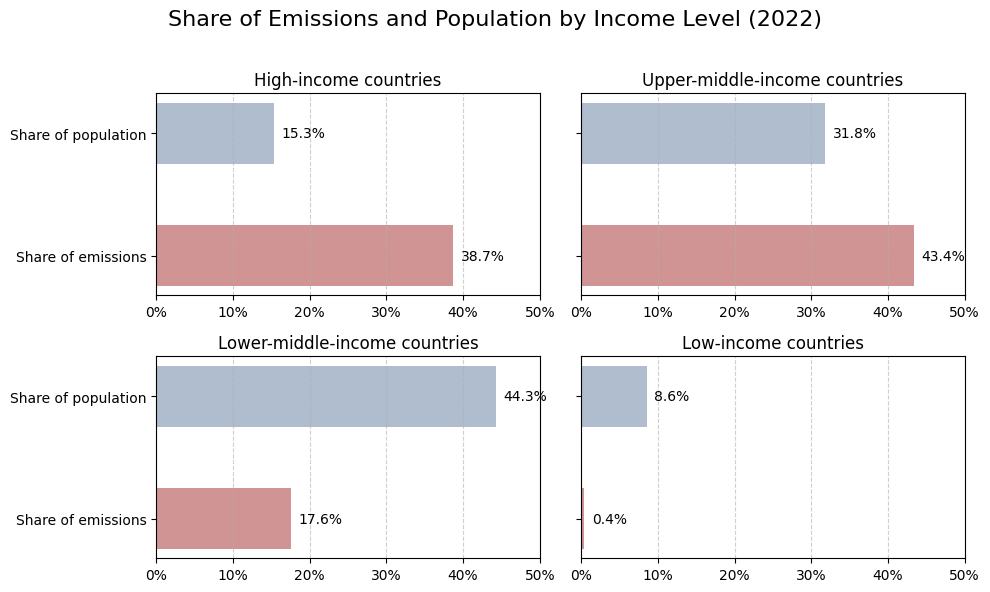

In [89]:
fig, axes = plt.subplots(2, 2, figsize=(10, 6), sharey=True)

# Mapping income levels to axes
for ax, (level, data) in zip(axes.flatten(), summary.iterrows()):
    # Add vertical grid lines first
    ax.grid(True, axis='x', linestyle='--', alpha=0.6)

    # Plot bars with transparency
    ax.barh(['Share of emissions'], data['share_emissions'], color='brown', alpha=0.5, height=0.5, label='Share of emissions')
    ax.barh(['Share of population'], data['share_population'], color='#607d9f', alpha=0.5, height=0.5, label='Share of population')
    
    # Add values after bars
    ax.text(data['share_emissions'] + 1, 0, f"{data['share_emissions']:.1f}%", va='center', color='black', fontsize=10)
    ax.text(data['share_population'] + 1, 1, f"{data['share_population']:.1f}%", va='center', color='black', fontsize=10)
    
    ax.set_title(f"{data['income_level']} countries", fontsize=12)
    
    # Set x-axis limits and add % formatter
    ax.set_xlim(0, 50)
    ax.xaxis.set_major_formatter(PercentFormatter())

# Add overall titles and labels
fig.suptitle('Share of Emissions and Population by Income Level (2022)', fontsize=16)
fig.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

- High income countries are emitting the most of the co2 in the world. 
- Higher and upper-middle income countries share the most of the emissions. 
- Emissions from low income countries are around 15% of the total emissions.

# Question 4: Is there any relationship between population and CO2 Emissions?

The dataset provides insights into global CO₂ emissions relative to population share across countries and years. Here's a brief description:

- **Columns**:
  - `Entity`: Name of the country or region.
  - `Code`: ISO-3 country code.
  - `Year`: Year of observation.
  - `Share of global annual CO₂ emissions`: Proportion of global CO₂ emissions attributed to the entity.
  - `Share of world population`: Proportion of the global population in the entity.
  - `World Bank's income classification`: Income classification of the entity (if available).

- **Number of Rows**: 60,918
- **Number of Columns**: 6


In [90]:
# Import required libraries
import pandas as pd
import plotly.express as px

# Read the CSV file
df = pd.read_csv('data/share-co2-emissions-vs-population.csv')

# Clean data - remove rows with missing values
df = df.dropna()

# Create animated scatter plot
fig = px.scatter(df,
                 x="Share of world population",
                 y="Share of global annual CO₂ emissions",
                 animation_frame="Year",
                 animation_group="Entity",
                 size="Share of global annual CO₂ emissions",
                 color="World Bank's income classification",
                 hover_name="Entity",
                 log_x=True,
                 log_y=True,
                 size_max=100,  # Increased size of points
                 title="CO2 Emissions vs Population Share by Country (1949-1988)")

# Update layout to match the x-axis and y-axis scale and make the canvas larger
fig.update_layout(
    xaxis=dict(
        title="Share of World Population",
        type="log",
        range=[-3, 3],  # Log scale for 0.001% (10^-3) to 10% (10^3)
        tickvals=[0.001, 0.01, 0.1, 1, 10],
        ticktext=["0.001%", "0.01%", "0.1%", "1%", "10%"]
    ),
    yaxis=dict(
        title="Share of Global CO₂ Emissions",
        type="log",
        range=[-3, 3],  # Log scale for 0.001% (10^-3) to 10% (10^3)
        tickvals=[0.001, 0.01, 0.1, 1, 10],
        ticktext=["0.001%", "0.01%", "0.1%", "1%", "10%"]
    ),
    width=1000,  # Increased canvas width
    height=700,  # Increased canvas height
    showlegend=True
)

# Add play and pause button animation settings
fig.update_layout(
    updatemenus=[{
        'type': 'buttons',
        'showactive': True,
        'buttons': [
            {
                'label': 'Play',
                'method': 'animate',
                'args': [None, {'frame': {'duration': 200, 'redraw': False}, 'fromcurrent': True}]
            },
            {
                'label': 'Pause',
                'method': 'animate',
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate'}]
            }
        ]
    }]
)

# Show plot
fig.show()

# # Optional: Save as HTML file
# fig.write_html("co2_vs_population_animation.html")


- We can observe an intersting linear relationship between Global CO2 Emissions and the World Population.
- Higher the population, higher their CO2 emissions, which makes sense because more people means more consumption of resources and more waste generation.
- But population is not a factor that the government can control or reduce, so it is important to focus on reducing the emissions from various other aspects.
- For example "which sectors contribute the most to the emissions, and what are the policies that can be implemented to reduce the emissions?" is a more relevant question to ask.

# Question 5: Which sector has highest impact on CO2 emissions?

This dataset contains annual greenhouse gas emissions by sector from 1990 to 2021. The sectors include 
- Energy
- Industrial Processes
- Agriculture
- Waste
- Land-Use Change and Forestry 

**Source:** [Climate Watch](https://www.climatewatchdata.org/ghg-emissions)

> NOTE: Emissions are measured in million tonnes of CO2 equivalent (MtCO2e).

In [91]:
import pandas as pd 
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
data = pd.read_csv("data/ghg-emissions.csv")

In [92]:
# Use the aggregated data from the bar chart
bar_data = data.groupby('Sector').sum().reset_index()

# Use absolute values for the pie chart to include all categories
bar_data['Emissions'] = bar_data['Emissions'].abs()

fig_pie = px.pie(bar_data, 
                 values='Emissions', 
                 names='Sector', 
                 title='Sectoral Distribution of Emissions',
                 hover_data={'Emissions': ':.2f'})
fig_pie.update_layout(title_x=0.5)
fig_pie.show()


- This chart shows the emissions by sector from 1990 to 2021. 
- The energy sector has the highest emissions, followed by industrial processes and agriculture. 
- What's important to note here is the Land-Use Change and Forestry sector, which has the least contribution to CO2 emissions.
- This sector is crucial for carbon sequestration and can be used to offset emissions from other sectors.

In [93]:
def create_sector_emissions_animation(data_df):
    # Prepare data
    data = data_df.groupby(['Year', 'Sector'])['Emissions'].sum().reset_index()
    unique_sectors = data['Sector'].unique()
    
    # Skip frames: Use every nth year for faster animations
    n = 2
    data = data[data['Year'] % n == 0]

    # Create frames for animation
    frames = []
    for year in sorted(data['Year'].unique()):
        frame_data = []
        for sector in unique_sectors:
            sector_data = data[(data['Year'] == year) & (data['Sector'] == sector)]
            frame_data.append(go.Bar(
                y=[sector],  # Single sector name
                x=sector_data["Emissions"].values if not sector_data.empty else [0],
                orientation='h',
                name=sector,
            ))
        
        # Calculate dynamic axis range
        min_x = data[data['Year'] <= year]['Emissions'].min()
        max_x = data[data['Year'] <= year]['Emissions'].max()
        
        frames.append(go.Frame(
            data=frame_data,
            name=str(year),
            layout=go.Layout(
                xaxis={"range": [min_x - 10, max_x + 10]}
            )
        ))

    # Slider steps
    slider_steps = []
    for year in sorted(data['Year'].unique()):
        slider_step = {
            "method": "animate",
            "args": [
                [str(year)],
                {
                    "frame": {"duration": 100, "redraw": True},
                    "mode": "immediate",
                    "transition": {"duration": 0}
                }
            ],
            "label": str(year)
        }
        slider_steps.append(slider_step)

    # Create the base figure
    base_data = []
    for sector in unique_sectors:
        sector_data = data[(data['Year'] == data['Year'].min()) & (data['Sector'] == sector)]
        base_data.append(go.Bar(
            y=[sector],
            x=sector_data["Emissions"].values if not sector_data.empty else [0],
            orientation='h',
            name=sector,
        ))

    fig = go.Figure(
        data=base_data,
        layout=go.Layout(
            title="Sector-Wise CO2 Emissions Over Time (Animated with Dynamic Axes)",
            yaxis=dict(title="Sector"),
            xaxis=dict(title="Emissions (MtCO2e)", range=[data['Emissions'].min() - 10, data['Emissions'].max() + 10]),
            width=950,
            height=600,
            updatemenus=[{
                "buttons": [
                    {
                        "args": [None, {
                            "frame": {"duration": 100, "redraw": False},
                            "fromcurrent": True,
                            "transition": {"duration": 0}
                        }],
                        "label": "Play",
                        "method": "animate"
                    },
                    {
                        "args": [[None], {
                            "frame": {"duration": 0, "redraw": False},
                            "mode": "immediate",
                            "transition": {"duration": 0}
                        }],
                        "label": "Pause",
                        "method": "animate"
                    }
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 87},
                "showactive": False,
                "type": "buttons",
                "x": 0.1,
                "xanchor": "right",
                "y": 0,
                "yanchor": "top"
            }],
            sliders=[{
                "active": 0,
                "yanchor": "top",
                "xanchor": "left",
                "currentvalue": {
                    "font": {"size": 20},
                    "prefix": "Year: ",
                    "visible": True,
                    "xanchor": "right"
                },
                "transition": {"duration": 300, "easing": "cubic-in-out"},
                "pad": {"b": 10, "t": 50},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": slider_steps
            }]
        ),
        frames=frames
    )

    return fig

fig = create_sector_emissions_animation(data)
fig.show()



We can observe that Energy Production is the single biggest contributor to the CO2 emissions. The other sectors like Industrial Processes, Agriculture, and Waste also contribute to the CO2 emissions but the impact is not as high Energy Production.
- Land-Use Change and Forestry has a negative impact on CO2 emissions. This means that the sector is absorbing more CO2 than it is emitting. This draws to our next question, which is, which countries are contributing to the land use and forestry?

## Follow-up for Question 5: CO2 Emission from Land-Use Change and Forestry

The dataset contains information about annual CO₂ emissions from land-use changes across countries and years. Here's a brief description:

- **Columns**: `['Entity', 'Code', 'Year', 'Annual CO2 emissions from land-use change']`
- **Number of Rows**: 37,236
- **Source**: [Our World in Data](https://ourworldindata.org/grapher/co2-land-use.csv?v=1&csvType=full&useColumnShortNames=true)

In [94]:
# Read the CSV file
df_land_use = pd.read_csv('data/co2-land-use.csv')

# Create animated choropleth map
fig_land_use = px.choropleth(df_land_use,
                             locations="Code",  # Country codes
                             locationmode="ISO-3",
                             color="Annual CO2 emissions from land-use change",
                             hover_name="Entity",
                             animation_frame="Year",
                             # use a blue and green color scale
                             color_continuous_scale=["blue", "white", "red"],
                             title="Annual CO2 Emissions from Land-Use Change (1850-2023)",
                             range_color=(-100_000_000, 100_000_000))

# Update layout
fig_land_use.update_layout(
    title_x=0.5,
    geo=dict(
        showframe=False,
        showcoastlines=True,
        projection_type='equirectangular'
    ),
    width=1000,
    height=600
)

# Set opacity
fig_land_use.update_traces(marker=dict(opacity=0.6))

# Add play and pause button settings
fig_land_use.update_layout(
    updatemenus=[{
        'type': 'buttons',
        'showactive': False,
        'buttons': [
            {
                'label': 'Play',
                'method': 'animate',
                'args': [None, {
                    'frame': {'duration': 10, 'redraw': True},
                    'fromcurrent': True,
                    'transition': {'duration': 0}
                }]
            },
            {
                'label': 'Pause',
                'method': 'animate',
                'args': [[None], {
                    'frame': {'duration': 0, 'redraw': False},
                    'mode': 'immediate',
                    'transition': {'duration': 0}
                }]
            }
        ]
    }]
)

# Show plot
fig_land_use.show()


- We can observe that Arab Countries like Saudi Arabia, Iraq, and Iran are consistently contributed the least to the CO2 emissions from Land-Use Change and Forestry. This is interesting because these countries are known for their oil production and transforming landscapes. 
- China, and India are among the biggest contributors to the CO2 emissions from Land-Use Change and Forestry. This is interesting because these countries are known for their rapid industrialization and urbanization.

# So, what can we do about this?

> NOTE: The rest of the analysis is continued on the Tableau Dashboard. Please refer to the Tableau Dashboard for more insights and recommendations.